In [2]:
import os, sys
os.environ['KMP_DUPLICATE_LIB_OK']='True'
sys.path.append("..")

import matplotlib
import matplotlib.pyplot as plt
from matplotlib import collections  as mc
%matplotlib inline

import random
import numpy as np
import os
import pandas as pd
import numpy as np
import torch
from torch.utils.data import Dataset
import time
import pylab as pl
import functools
from IPython import display
import logging
import os
import shutil
import sys
import tempfile
import random
import numpy as np
from sklearn.model_selection import train_test_split
from tqdm import trange
import matplotlib.pyplot as plt
import torch
from urllib.request import urlretrieve
import gzip
from PIL import Image
import pathlib
from pathlib import Path
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
import functools
from defconv import  DeformableConv2d

import monai
from monai.apps import download_and_extract
from monai.config import print_config

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

from IPython.display import clear_output
from tqdm.notebook import tqdm as tqdm

import gc

# from src import distributions
# import torch.nn.functional as F

# # NOT networks
# from src.resnet2 import ResNet_D
# from src.unet import UNet

# from src.tools import weights_init_D

# # Pix2Pix Networks
# from src.networks import NLayerDiscriminator, UnetGenerator, init_weights, get_norm_layer

# from src.u2net import U2NET
# from src.losses import VGGPerceptualLoss as VGGLoss

from copy import deepcopy
import json

from tqdm import tqdm_notebook as tqdm
from IPython.display import clear_output

import wandb
# from src.tools import fig2data, fig2img # for wandb

# This needed to use dataloaders for some datasets
from PIL import PngImagePlugin
LARGE_ENOUGH_NUMBER = 100
PngImagePlugin.MAX_TEXT_CHUNK = LARGE_ENOUGH_NUMBER * (1024**2)

DEVICE = 'cuda:0' if torch.cuda.is_available() else 'cpu'

ModuleNotFoundError: No module named 'defconv'

In [3]:
torch.__version__

'1.13.1+cu117'

In [4]:
%pip install wandb -qU
import wandb
wandb.login()
run = wandb.init(project="img2img-pix2pix",
                 config={"learning_rate": 2e-4 ,
                         "num_epochs": 100})

Note: you may need to restart the kernel to use updated packages.


KeyboardInterrupt: 

In [ ]:
!nvidia-smi

In [5]:
SEED = 1380
torch.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(SEED)
random.seed(SEED)
os.environ['PYTHONHASHSEED'] = str(SEED)

# Data preparation an processing

In [6]:
class FMRIConnectivityDataset(Dataset):
    def __init__(self, data_directory, ids, transform=None):
        self.transform = transform
        self.data = [] 

        for subject_id in ids:
            rest_file_path = os.path.join(data_directory, f"{subject_id}_rfMRI_REST1_LR.csv")
            motor_file_path = os.path.join(data_directory, f"{subject_id}_tfMRI_MOTOR_LR.csv")

            if os.path.exists(rest_file_path) and os.path.exists(motor_file_path):
                rest_data = pd.read_csv(rest_file_path)
                motor_data = pd.read_csv(motor_file_path)

                self.data.append((subject_id, rest_data.values, motor_data.values))

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        subject_id, rest_fMRI_matrix, motor_task_fMRI_matrix = self.data[idx]

        data_dict = {
            "subject_id": subject_id,
            "rest_fMRI_data": torch.FloatTensor(rest_fMRI_matrix[np.newaxis,:,:]),
            "motor_task_fMRI_data": torch.FloatTensor(motor_task_fMRI_matrix[np.newaxis,:,:])
        }

        return data_dict

In [7]:
import os
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader

data_directory = "data/"

# List all files in the data directory
file_names = [f for f in os.listdir(data_directory) if f.endswith(".csv")]

# Split the file names to extract the subject IDs
file_ids = list(set([file.split('_')[0] for file in file_names]))  

# Define the split ratios (80% train, 20% test)
train_ratio = 0.8
test_ratio = 0.2

# Perform train-test split without intersection
train_ids, remaining_ids = train_test_split(file_ids, test_size=test_ratio, random_state=1380)
test_ids = remaining_ids 

# Create datasets for the training and test sets
train_dataset = FMRIConnectivityDataset(data_directory, train_ids)
test_dataset = FMRIConnectivityDataset(data_directory, test_ids)

# Dataloaders for training and test sets
batch_size = 1
train_data_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_data_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [8]:
len(train_ids)

520

In [9]:
len(test_ids)

131

In [10]:
train_id_set = set(train_ids)
test_id_set = set(test_ids)
intersection = train_id_set.intersection(test_id_set)
intersection_list = list(intersection)

In [11]:
intersection_list

[]

In [12]:
len(intersection_list)

0

In [13]:
def freeze(model):
    for p in model.parameters():
        p.requires_grad_(False)
    model.eval()    
    
def unfreeze(model):
    for p in model.parameters():
        p.requires_grad_(True)
    model.train(True)

In [14]:
import random
from itertools import cycle

def sample_fMRI_data(data_loader):
    """
    Sample a batch of fMRI data containing both X (rest) and Y (motor) from a DataLoader.
    
    Args:
        data_loader (DataLoader): The DataLoader for the fMRI dataset.

    Returns:
        tuple of torch.Tensor: A tuple containing X (resting state data) and Y (motor task data).
    """
    if not hasattr(sample_fMRI_data, "data_iterator"):
        # Create an iterator that loops through the data_loader
        sample_fMRI_data.data_iterator = cycle(data_loader)

    batch = next(sample_fMRI_data.data_iterator)
    X = batch["rest_fMRI_data"]
    Y = batch["motor_task_fMRI_data"]

    return X, Y

In [15]:
test_data_rest, test_data_motor = sample_fMRI_data(test_data_loader)

In [16]:
test_data_rest_1, test_data_motor_1 = sample_fMRI_data(test_data_loader)

In [17]:
test_data_rest_2, test_data_motor_2 = sample_fMRI_data(test_data_loader)

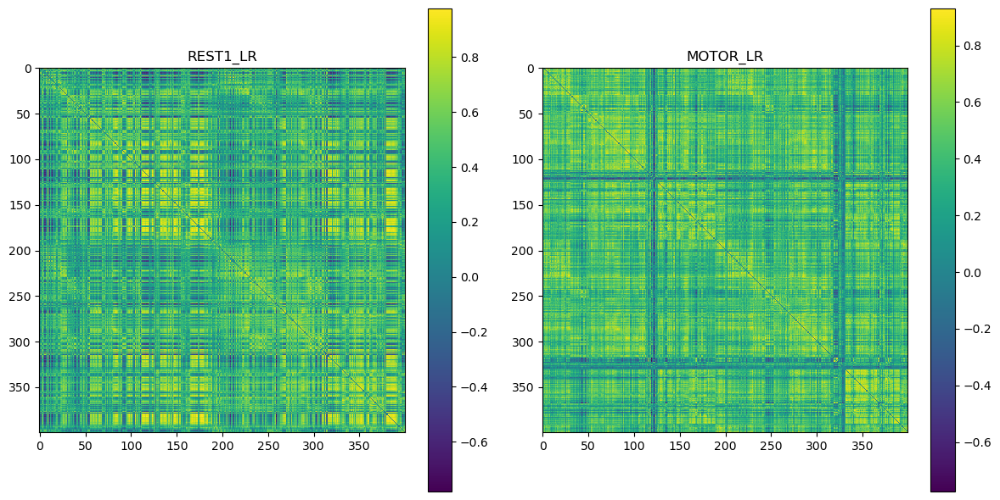

In [18]:
rest_data = np.loadtxt("data/580751_rfMRI_REST1_LR.csv", delimiter=",", skiprows=1)
motor_data = np.loadtxt("data/580751_tfMRI_MOTOR_LR.csv", delimiter=",", skiprows=1)

plt.figure(figsize=(12, 6)) 

# Heatmap for 580751_rfMRI_REST1_LR.csv
plt.subplot(1, 2, 1)
plt.imshow(rest_data, cmap='viridis', interpolation='nearest')
plt.title("REST1_LR")
plt.colorbar()

# Heatmap for 580751_rfMRI_MOTOR_LR.csv
plt.subplot(1, 2, 2)
plt.imshow(motor_data, cmap='viridis', interpolation='nearest')
plt.title("MOTOR_LR")
plt.colorbar()

plt.tight_layout()  
plt.show()

In [19]:
# Function to plot original and predicted matrices
def plot_original_and_predicted(rest, original, predicted, title_original_rest, title_original_motor, title_predicted):
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    # Original Rest data
    axes[0].set_title(title_original_rest)
    axes[0].imshow(rest[0][0].cpu().detach().numpy(), cmap='viridis', interpolation='nearest')
    axes[0].axis('off')

    # Original Motor data
    axes[1].set_title(title_original_motor)
    axes[1].imshow(original[0][0].cpu().detach().numpy(), cmap='viridis', interpolation='nearest')
    axes[1].axis('off')
    
      # Predicted data
    axes[2].set_title(title_predicted)
    axes[2].imshow(predicted[0][0].cpu().detach().numpy(), cmap='viridis', interpolation='nearest')
    axes[2].axis('off')
    
    plt.show()


# NOT unpaired

## CNN for transport and mapping

In [17]:
import torch.nn as nn

# Transport model T
T = nn.Sequential(
    nn.Conv2d(1, 128, kernel_size=5, padding=2),
    nn.ReLU(True),
    nn.Conv2d(128, 128, kernel_size=5, padding=2),
    nn.ReLU(True),
    nn.Conv2d(128, 128, kernel_size=5, padding=2),
    nn.ReLU(True),
    nn.Conv2d(128, 128, kernel_size=5, padding=2),
    nn.ReLU(True),
    nn.Conv2d(128, 128, kernel_size=5, padding=2),
    nn.ReLU(True),
    nn.Conv2d(128, 128, kernel_size=5, padding=2),
    nn.ReLU(True),
    nn.Conv2d(128, 1, kernel_size=5, padding=2), 
).to(DEVICE)


# Mapping model f
f = nn.Sequential(
    nn.Conv2d(1, 128, kernel_size=5, padding=2, stride=2),
    nn.ReLU(True),
    nn.AvgPool2d(2),  
    nn.Conv2d(128, 256, kernel_size=5, padding=2, stride=2),
    nn.ReLU(True),
    nn.AvgPool2d(2),  
    nn.Conv2d(256, 512, kernel_size=5, padding=2, stride=2),
    nn.ReLU(True),
    nn.AvgPool2d(2),  
    nn.Conv2d(512, 512, kernel_size=3, padding=1, stride=2),
    nn.ReLU(True),
    nn.AvgPool2d(2),  
    nn.Conv2d(512, 1, kernel_size=1, padding=0),
    nn.Flatten(1),
).to(DEVICE)

T_opt = torch.optim.Adam(T.parameters(), lr=1e-4, weight_decay=1e-10)
f_opt = torch.optim.Adam(f.parameters(), lr=1e-4, weight_decay=1e-10)

print('T params:', np.sum([np.prod(p.shape) for p in T.parameters()]))
print('f params:', np.sum([np.prod(p.shape) for p in f.parameters()]))


T params: 2055169
f params: 6460417


## Unet generator architecture

In [20]:
# custom weights initialization called on generator and discriminator        
def weights_init(net, init_type='normal', scaling=0.02):
    """Initialize network weights.
    Parameters:
        net (network)   -- network to be initialized
        init_type (str) -- the name of an initialization method: normal | xavier | kaiming | orthogonal
        init_gain (float)    -- scaling factor for normal, xavier and orthogonal.
    We use 'normal' in the original pix2pix and CycleGAN paper. But xavier and kaiming might
    work better for some applications. Feel free to try yourself.
    """
    def init_func(m):  # define the initialization function
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and (classname.find('Conv')) != -1:
            torch.nn.init.normal_(m.weight.data, 0.0, scaling)
        elif classname.find('BatchNorm2d') != -1:  # BatchNorm Layer's weight is not a matrix; only normal distribution applies.
            torch.nn.init.normal_(m.weight.data, 1.0, scaling)
            torch.nn.init.constant_(m.bias.data, 0.0)

    print('initialize network with %s' % init_type)
    net.apply(init_func)  # apply the initialization function <init_func>

In [21]:
def get_norm_layer():
    """Return a normalization layer
       For BatchNorm, we use learnable affine parameters and track running statistics (mean/stddev).
    """
    norm_type = 'batch'
    if norm_type == 'batch':
        norm_layer = functools.partial(nn.BatchNorm2d, affine=True, track_running_stats=True)
    return norm_layer

In [22]:
class UnetGenerator(nn.Module):
    """Create a Unet-based generator"""

    def __init__(self, input_nc, output_nc, nf=64, norm_layer=nn.BatchNorm2d, use_dropout=False):
        """Construct a Unet generator
        Parameters:
            input_nc (int)  -- the number of channels in input images
            output_nc (int) -- the number of channels in output images
            num_downs (int) -- the number of downsamplings in UNet. For example, # if |num_downs| == 7,
                                image of size 128x128 will become of size 1x1 # at the bottleneck
            nf (int)       -- the number of filters in the last conv layer
            norm_layer      -- normalization layer
        We construct the U-Net from the innermost layer to the outermost layer.
        It is a recursive process.
        """
        super(UnetGenerator, self).__init__()
        # construct unet structure
        unet_block = UnetSkipConnectionBlock(nf * 8, nf * 8, input_nc=None, submodule=None, norm_layer=norm_layer, innermost=True)  # add the innermost layer
        
        # add intermediate layers with ngf * 8 filters
        unet_block = UnetSkipConnectionBlock(nf * 8, nf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
        unet_block = UnetSkipConnectionBlock(nf * 8, nf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
        unet_block = UnetSkipConnectionBlock(nf * 8, nf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
        
        # gradually reduce the number of filters from nf * 8 to nf
        unet_block = UnetSkipConnectionBlock(nf * 4, nf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        unet_block = UnetSkipConnectionBlock(nf * 2, nf * 4, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        unet_block = UnetSkipConnectionBlock(nf, nf * 2, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        self.model = UnetSkipConnectionBlock(output_nc, nf, input_nc=input_nc, submodule=unet_block, outermost=True, norm_layer=norm_layer)  # add the outermost layer

    def forward(self, input):
        """Standard forward"""
        return self.model(input)

In [23]:
class UnetSkipConnectionBlock(nn.Module):
    def __init__(self, outer_nc, inner_nc, input_nc=None,
                 submodule=None, outermost=False, innermost=False, norm_layer=nn.BatchNorm2d, use_dropout=False):
        super(UnetSkipConnectionBlock, self).__init__()
        self.outermost = outermost
        if input_nc is None:
            input_nc = outer_nc

        downconv = nn.Conv2d(input_nc, inner_nc, kernel_size=3, stride=1, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = norm_layer(inner_nc)

        uprelu = nn.ReLU(True)
        upnorm = norm_layer(outer_nc)

        if outermost:
            # Modify the kernel size for the outermost upconv layer
            upconv = nn.ConvTranspose2d(inner_nc*2, outer_nc,
                                        kernel_size=3, stride=1, padding=1)  # Adjusted kernel_size and stride
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(inner_nc, outer_nc,
                                        kernel_size=3, stride=1,
                                        padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(inner_nc*2, outer_nc,
                                        kernel_size=3, stride=1,
                                        padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]

            if use_dropout:
                model = down + [submodule] + up + [nn.Dropout(0.5)]
            else:
                model = down + [submodule] + up

        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:   # add skip connections
            model_x = self.model(x)
            # print("x size:", x.size())
            # print("model_x size:", model_x.size())
            return torch.cat([x, model_x], 1)

In [24]:
norm_layer = get_norm_layer()

device = 'cuda:0'
norm_layer = get_norm_layer()

# Create the generator
T = UnetGenerator(1, 1, 64, norm_layer=norm_layer, use_dropout=False)
T.apply(lambda x: weights_init(x, init_type='normal', scaling=0.02))
T = T.to(device)
#generator = torch.nn.DataParallel(generator)
inp = torch.ones(1, 1, 400, 400)
inp = inp.to(device)

# Debug 
print("Input Tensor Size:", inp.size())

# Generate output
gen = T(inp)

# Debug 
print("Generated Tensor Size:", gen.size())

initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initiali

## PatchGAN descriminator architecture

In [25]:
class Discriminator(nn.Module):
    """Defines a PatchGAN discriminator"""

    def __init__(self, input_nc, ndf=64, n_layers=3, norm_layer=nn.BatchNorm2d):
        """Construct a PatchGAN discriminator
        Parameters:
            input_nc (int)  -- the number of channels in input images
            ndf (int)       -- the number of filters in the last conv layer
            n_layers (int)  -- the number of conv layers in the discriminator
            norm_layer      -- normalization layer
        """
        super(Discriminator, self).__init__()
        kw = 4
        padw = 1
        sequence = [nn.Conv2d(input_nc, ndf, kernel_size=kw, stride=2, padding=padw), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        nf_mult_prev = 1
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence += [
                nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=2, padding=padw, bias=False),
                norm_layer(ndf * nf_mult),
                nn.LeakyReLU(0.2, True)
            ]

        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence += [
            nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=1, padding=padw, bias=False),
            norm_layer(ndf * nf_mult),
            nn.LeakyReLU(0.2, True)
        ]

        sequence += [nn.Conv2d(ndf * nf_mult, 1, kernel_size=kw, stride=1, padding=padw), nn.Sigmoid()]  # output 1 channel prediction map
        self.model = nn.Sequential(*sequence)

    def forward(self, input):
        """Standard forward."""
        return self.model(input)

In [26]:
f = Discriminator(2, 64, n_layers=3, norm_layer=norm_layer)#.cuda().float()
f.apply(weights_init)
f=f.cuda()

initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal
initialize network with normal


In [28]:
inp = torch.ones(1,2,400,400).cuda()
f.shape = f(inp)
f.shape

tensor([[[[0.1622, 0.1313, 0.1441,  ..., 0.2288, 0.1703, 0.1323],
          [0.7855, 0.3233, 0.8791,  ..., 0.6311, 0.8968, 0.6519],
          [0.6674, 0.2596, 0.8892,  ..., 0.3092, 0.7319, 0.3977],
          ...,
          [0.8156, 0.4372, 0.9734,  ..., 0.8140, 0.9735, 0.9231],
          [0.2548, 0.0709, 0.4693,  ..., 0.3145, 0.8235, 0.5419],
          [0.9250, 0.7509, 0.9222,  ..., 0.8862, 0.9833, 0.8302]]]],
       device='cuda:0', grad_fn=<SigmoidBackward0>)

In [123]:
# def weights_init_D(m):
#     classname = m.__class__.__name__
#     if classname.find('Conv') != -1:
#         nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='leaky_relu')
#     elif classname.find('BatchNorm') != -1:
#         nn.init.constant_(m.weight, 1)
#         nn.init.constant_(m.bias, 0)
        
# def weights_init_mlp(m):
#     classname = m.__class__.__name__
#     if classname.find('Linear') != -1:
#         nn.init.kaiming_normal_(m.weight, mode='fan_in', nonlinearity='relu')

In [124]:
# DEVICE_IDS = [1]

# # Initialize ResNet discriminator
# f = Discriminator(400, nc=3).cuda(1)
# f.apply(weights_init_D)

# # Initialize U-Net
# T = UNet(1, 2, base_factor=48).cuda(1)

# # Use DataParallel if multiple GPUs are available
# if len(DEVICE_IDS) > 1:
#     T = nn.DataParallel(T, DEVICE)
#     f = nn.DataParallel(f, DEVICE)

# # Print the number of parameters for each network
# print('T params:', np.sum([np.prod(p.shape) for p in T.parameters()]))
# print('f params:', np.sum([np.prod(p.shape) for p in f.parameters()]))

T params: 7530674
f params: 41811905


### STRONG cost

In [29]:
def sq_cost (X, Y):
  return (X-Y).square().flatten(start_dim=1).mean(dim=1)

COST = sq_cost

In [30]:
COST = sq_cost

# Other parameters
T_ITERS = 10
MAX_STEPS = 300 + 1

### Perceptual Loss

In [31]:
class VGGPerceptualLoss(nn.Module):
    def __init__(self, layer_names=['3', '8', '15', '22']):
        super(VGGPerceptualLoss, self).__init__()
        self.vgg_layers = models.vgg16(pretrained=True).features
        self.layer_names = layer_names
        self.eval()
        
    def __call__(self, in_1, in_2):
        assert in_1.shape == in_2.shape
        loss = 0.
        out_1 = in_1; out_2 = in_2
        for name, module in self.vgg_layers._modules.items():
            out_1 = module(out_1); out_2 = module(out_2);
            if name in self.layer_names:
                loss += F.mse_loss(out_1, out_2, reduction='none').flatten(start_dim=1).mean(dim=1)
        return loss

class InjectiveVGGPerceptualLoss(nn.Module):
    def __init__(self, layer_names=['3', '8', '15', '22'], w_vgg=0.02, w_l2=1., w_l1=1./3):
        super(InjectiveVGGPerceptualLoss, self).__init__()
        self.w_vgg, self.w_l2, self.w_l1 = w_vgg, w_l2, w_l1
        self.vgg_loss = VGGPerceptualLoss(layer_names=layer_names)
        self.l2_loss = L2Loss()
        self.l1_loss = L1Loss()
        self.eval()
        
    def __call__(self, in_1, in_2):
        assert in_1.shape == in_2.shape
        return self.w_vgg * self.vgg_loss(in_1, in_2) + self.w_l2 * self.l2_loss(in_1, in_2) + self.w_l1 * self.l1_loss(in_1, in_2)

## NOT algorithm

In [128]:
# T.load_state_dict(torch.load('weights_T.pth'))
# f.load_state_dict(torch.load('weights_f.pth'))

In [32]:
T_opt = torch.optim.Adam(T.parameters(), lr=1e-4, weight_decay=1e-10)
f_opt = torch.optim.Adam(f.parameters(), lr=1e-4, weight_decay=1e-10)

In [33]:
T_ITERS = 10
f_LR, T_LR = 1e-4, 1e-4
IMG_SIZE = 64

BATCH_SIZE = 64

PLOT_INTERVAL = 100
COST = 'mse' # Mean Squared Error
CPKT_INTERVAL = 2000
MAX_STEPS = 101
SEED = 0x000000

In [34]:
import warnings
warnings.filterwarnings('ignore')

T.train(True)
f.eval()

for step in tqdm(range(MAX_STEPS)):
    T_opt_counter = 0
    for batch_data in train_data_loader:
        if T_opt_counter == T_ITERS:
            break 
        rest_batch = batch_data["rest_fMRI_data"].to(DEVICE)
        motor_batch = batch_data["motor_task_fMRI_data"].to(DEVICE)
        
        T_opt.zero_grad()
        T_X = T(rest_batch)
        if COST == 'mse':
            T_loss = F.mse_loss(rest_batch, T_X).mean() - f(T_X).mean()
        else:
            raise Exception('Unknown COST')
        T_loss.backward()
        T_opt.step()
        T_opt_counter += 1

    # f optimization
    T.eval()
    f.train(True)
    
    rest_batch = batch_data["rest_fMRI_data"].to(DEVICE)
    motor_batch = batch_data["motor_task_fMRI_data"].to(DEVICE)
    
    f_opt.zero_grad()
    T_X_train = T(rest_batch)
    f_loss = f(T_X_train).mean() - f(motor_batch).mean()
    f_loss.backward()
    f_opt.step()
        
    if step % 10 == 0:
        clear_output(wait=True)
        print("Step", step)
        with torch.no_grad():
            T_X_test_fixed = T(test_data_rest.to(DEVICE))
            T_X_test_fixed = T_X_test_fixed.to('cpu')
            T_X_test_fixed_1 = T(test_data_rest_1.to(DEVICE))
            T_X_test_fixed_1 = T_X_test_fixed_1.to('cpu')
            T_X_test_fixed_2 = T(test_data_rest_2.to(DEVICE))
            T_X_test_fixed_2 = T_X_test_fixed_2.to('cpu')
            plot_original_and_predicted(test_data_rest, test_data_motor, T_X_test_fixed, 'original_rest_1', 'original_motor_1', 'predicted_1')
            plot_original_and_predicted(test_data_rest_1, test_data_motor_1, T_X_test_fixed_1, 'original_rest_2', 'original_motor_2', 'predicted_2')
            plot_original_and_predicted(test_data_rest_2, test_data_motor_2, T_X_test_fixed_2, 'original_rest_3', 'original_motor_3', 'predicted_3')


OutOfMemoryError: CUDA out of memory. Tried to allocate 314.00 MiB (GPU 0; 10.92 GiB total capacity; 9.90 GiB already allocated; 176.19 MiB free; 9.98 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

Step 300


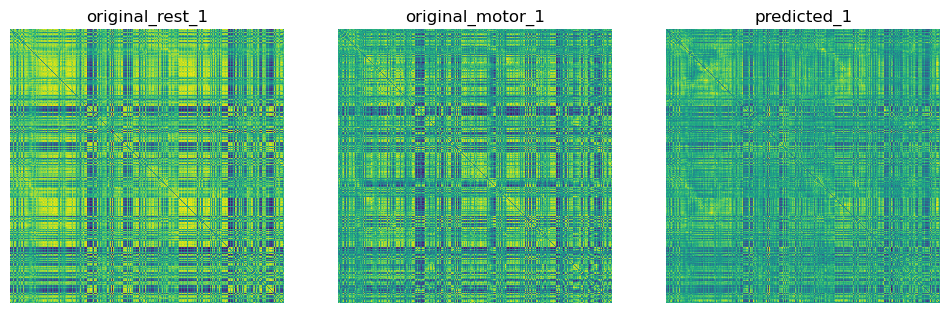

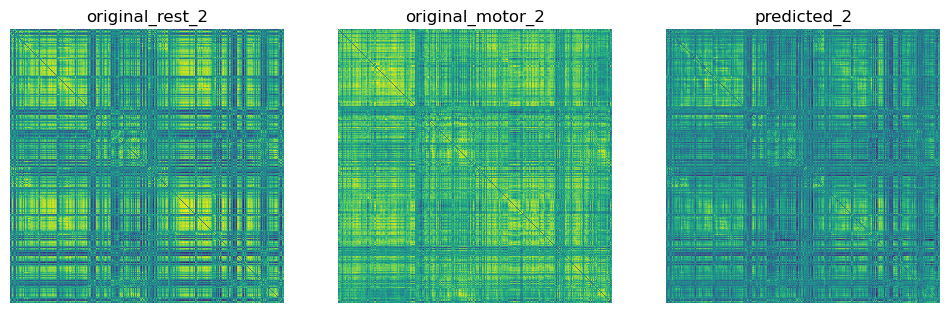

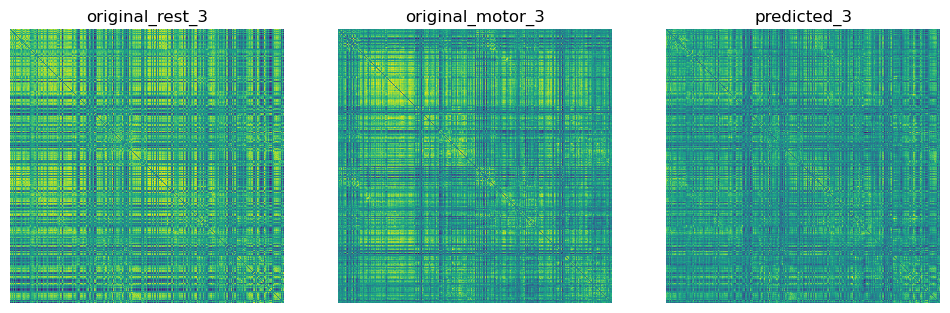

In [20]:
import warnings
warnings.filterwarnings('ignore')

T.train(True)
f.eval()

for step in tqdm(range(MAX_STEPS)):
    T_opt_counter = 0
    for batch_data in train_data_loader:
        if T_opt_counter == T_ITERS:
            break 
        rest_batch = batch_data["rest_fMRI_data"].to(DEVICE)  # Ensure data is on the same device as your model
        motor_batch = batch_data["motor_task_fMRI_data"].to(DEVICE)
        T_loss = COST(rest_batch, T(rest_batch)).mean() - f(T(rest_batch)).mean()
        T_opt.zero_grad()
        T_loss.backward()
        T_opt.step()
        T_opt_counter += 1

    # f optimization
    T.eval()
    f.train(True)
    rest_batch = batch_data["rest_fMRI_data"].to(DEVICE)
    motor_batch = batch_data["motor_task_fMRI_data"].to(DEVICE)
    T_X_train = T(rest_batch).to(DEVICE)
    f_loss = f(T(rest_batch)).mean() - f(motor_batch).mean()
    f_opt.zero_grad()
    f_loss.backward()
    f_opt.step()
        
    if step % 10 == 0:
        clear_output(wait=True)
        print("Step", step)
        with torch.no_grad():
            T_X_test_fixed = T(test_data_rest.to(DEVICE))
            T_X_test_fixed = T_X_test_fixed.to('cpu')
            T_X_test_fixed_1 = T(test_data_rest_1.to(DEVICE))
            T_X_test_fixed_1 = T_X_test_fixed_1.to('cpu')
            T_X_test_fixed_2 = T(test_data_rest_2.to(DEVICE))
            T_X_test_fixed_2 = T_X_test_fixed_2.to('cpu')
            plot_original_and_predicted(test_data_rest, test_data_motor, T_X_test_fixed, 'original_rest_1', 'original_motor_1', 'predicted_1')
            plot_original_and_predicted(test_data_rest_1, test_data_motor_1, T_X_test_fixed_1, 'original_rest_2', 'original_motor_2', 'predicted_2')
            plot_original_and_predicted(test_data_rest_2, test_data_motor_2, T_X_test_fixed_2, 'original_rest_3', 'original_motor_3', 'predicted_3')


    -  сделать синтетически непарный датасет
    -  MSE regression попробовать
    -  найти непарные сетап
    -  посмотеррть как работает на непарном обучении и парном
    -  Александр отправит код для парного обучения

In [ ]:
torch.save(T.state_dict(), '/workspace/Kalimullin/Image_to_image/weights_T.pth')
torch.save(f.state_dict(), '/workspace/Kalimullin/Image_to_image/weights_f.pth')

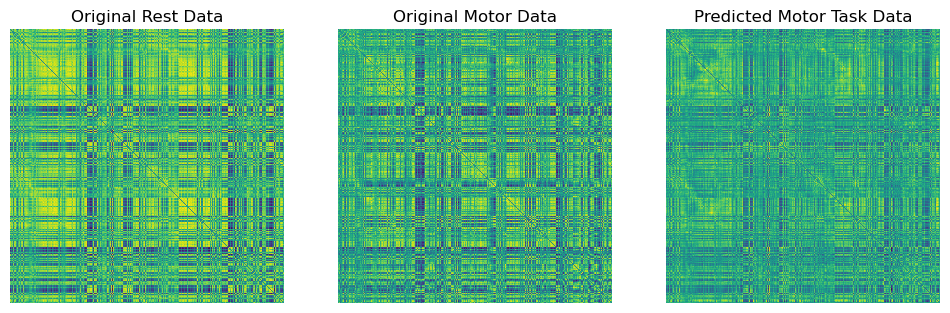

MSE: 0.07761048525571823


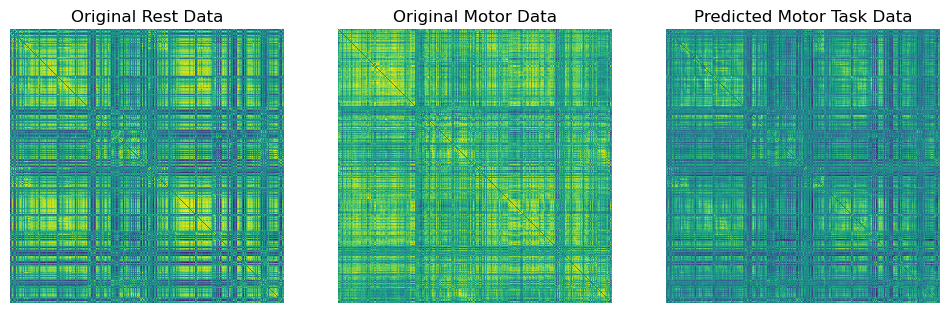

MSE: 0.06958581507205963


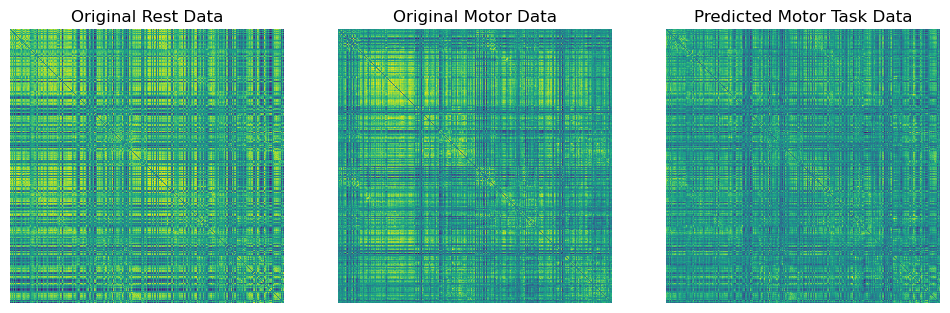

MSE: 0.062314629554748535


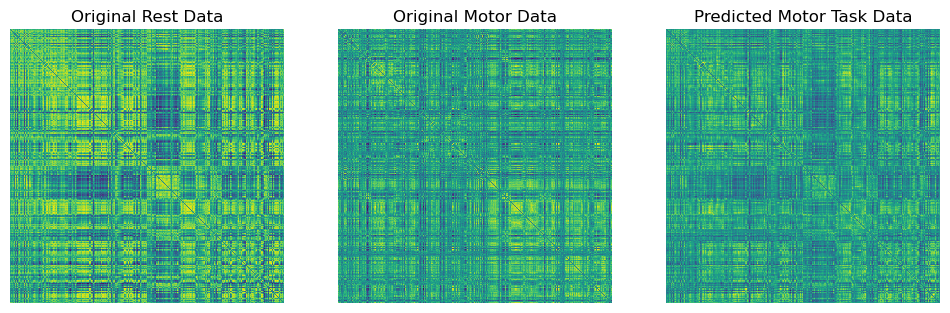

MSE: 0.06619421392679214


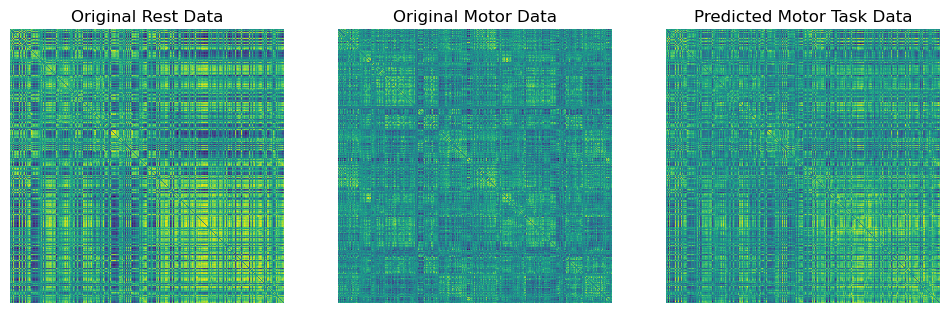

MSE: 0.0569339394569397


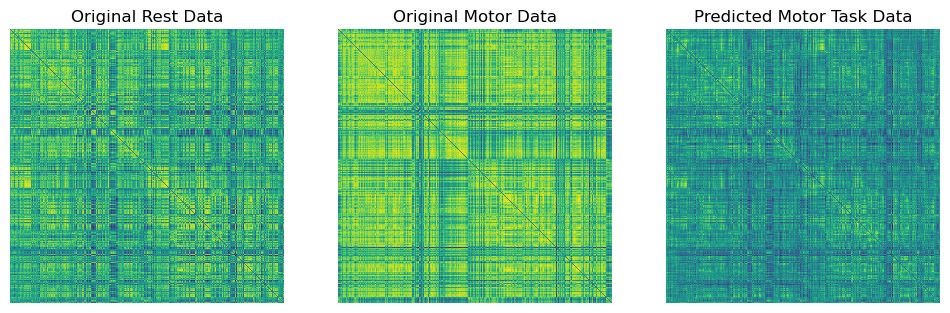

MSE: 0.07565122097730637


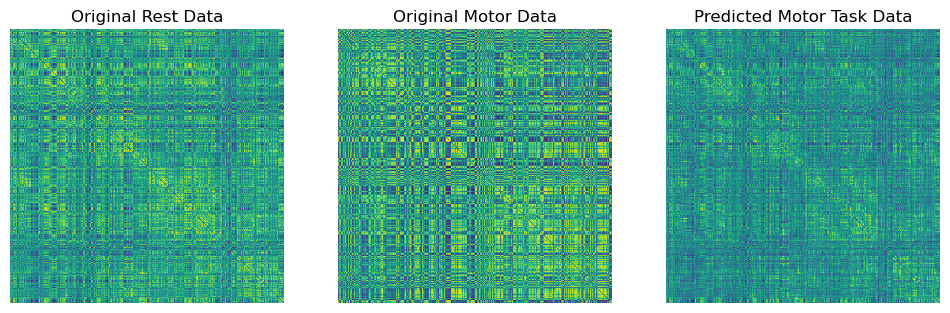

MSE: 0.09139080345630646


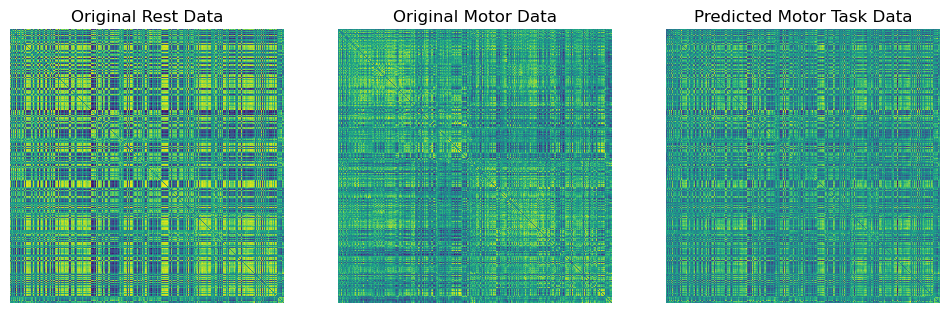

MSE: 0.05822337791323662


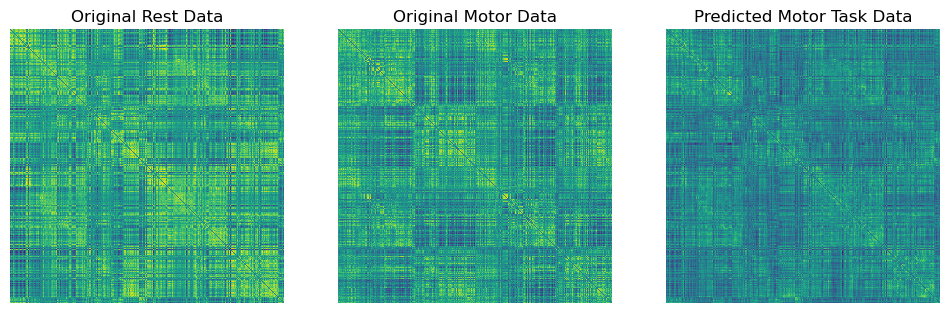

MSE: 0.06857122480869293


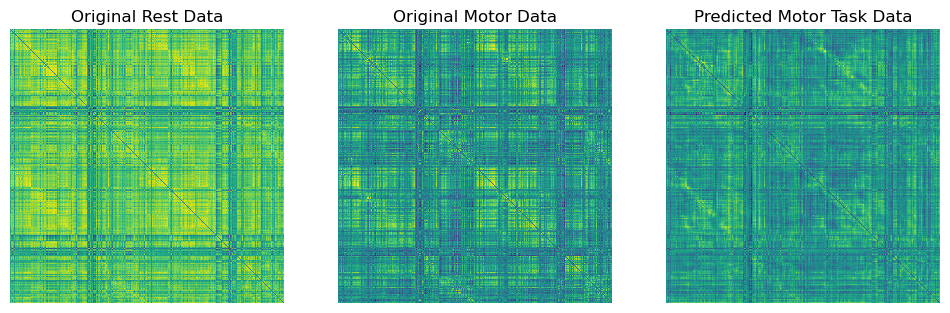

MSE: 0.066933773458004


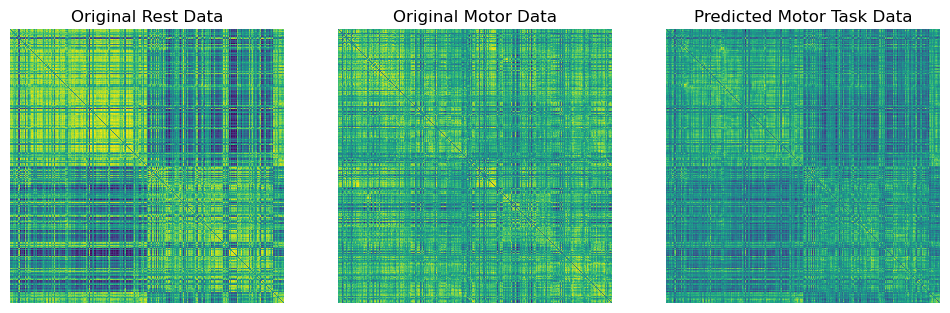

MSE: 0.0752820372581482


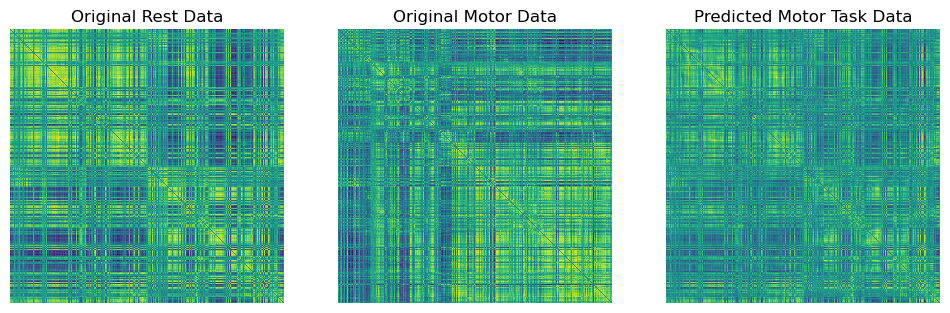

MSE: 0.07242905348539352


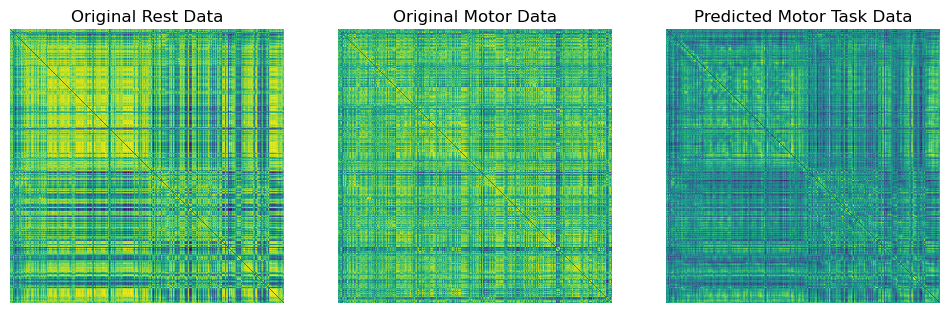

MSE: 0.06936416029930115


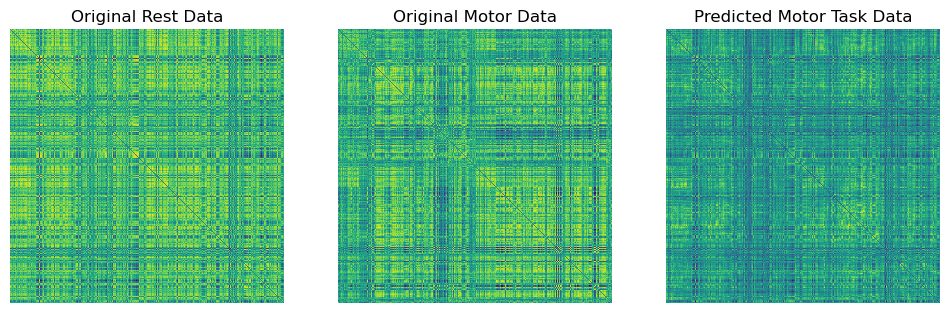

MSE: 0.05828515440225601


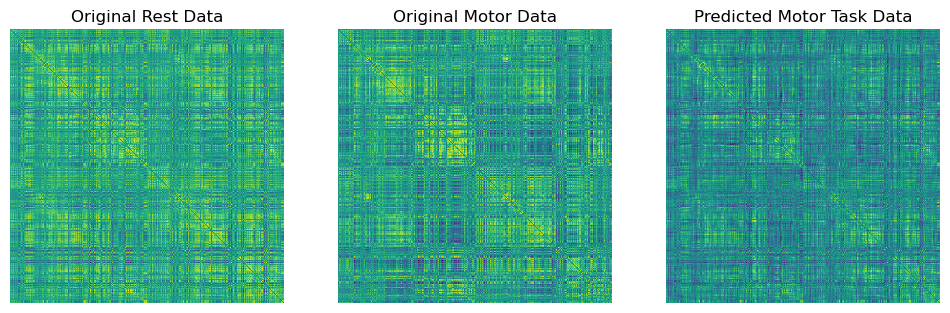

MSE: 0.05660594627261162


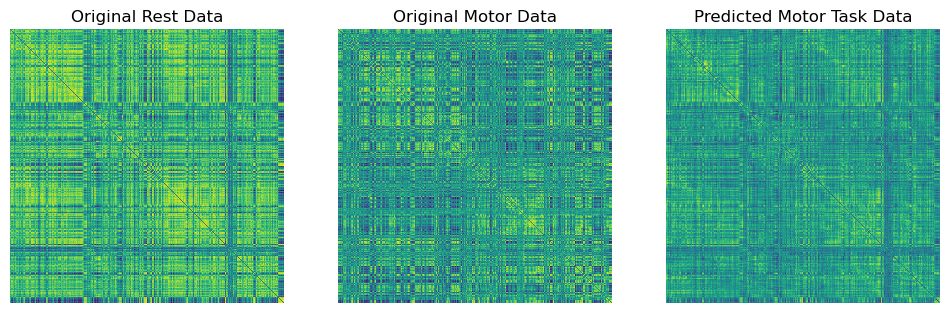

MSE: 0.08702238649129868


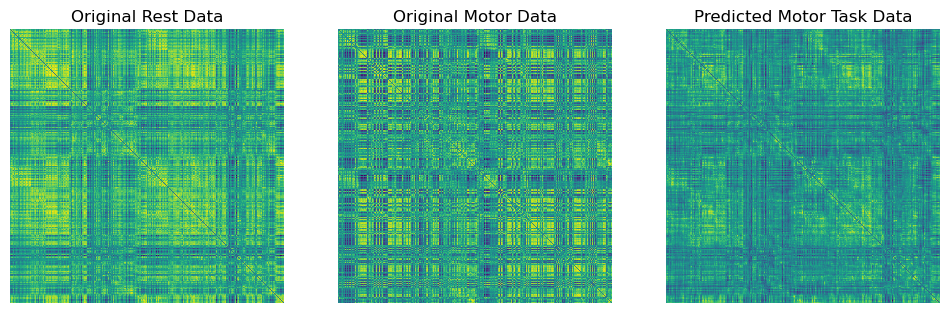

MSE: 0.10684466361999512


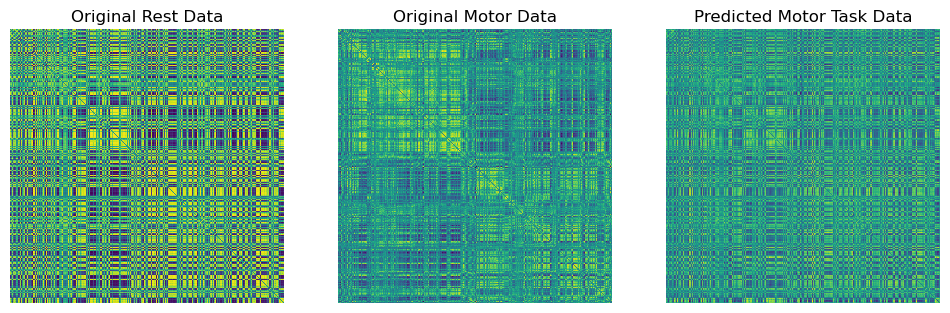

MSE: 0.12166694551706314


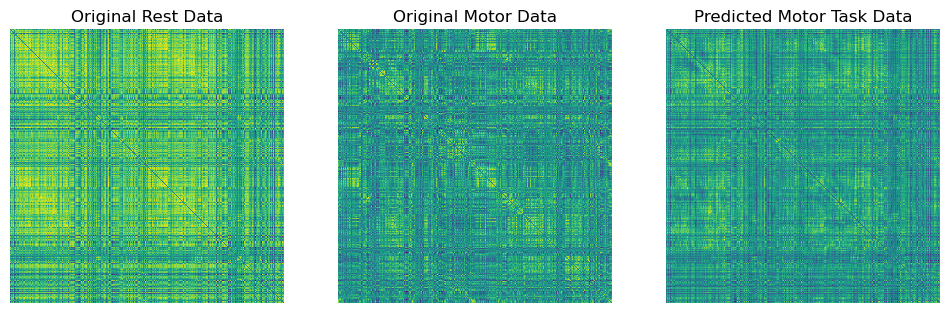

MSE: 0.07996632903814316


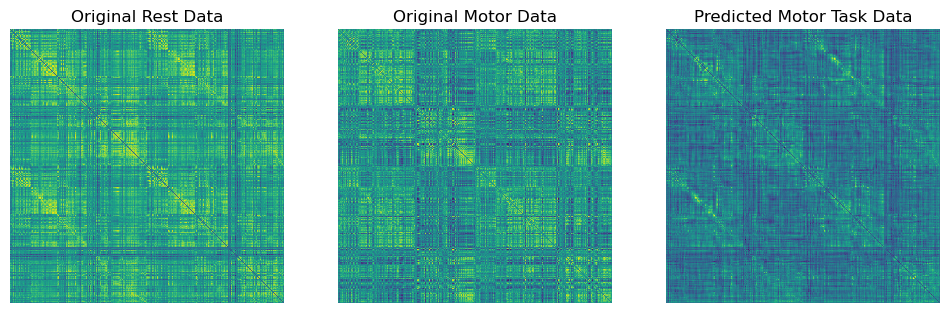

MSE: 0.06780816614627838


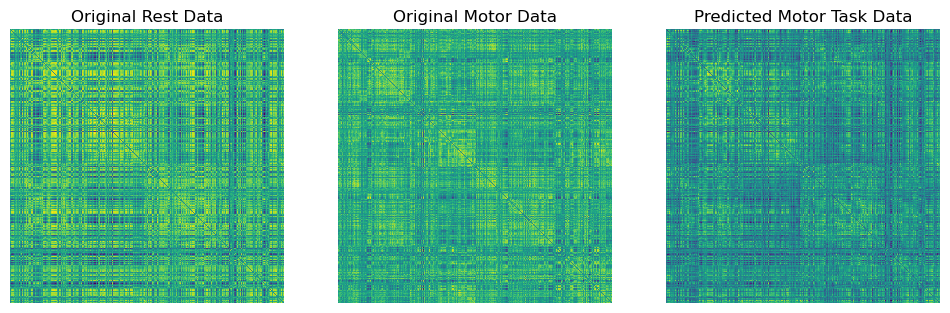

MSE: 0.05917123705148697


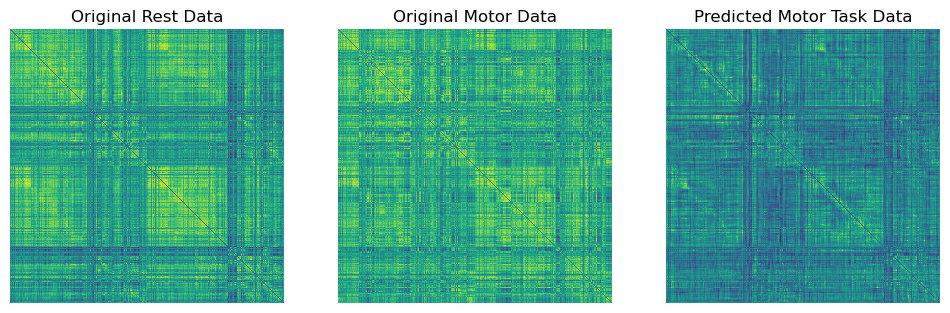

MSE: 0.08335833251476288


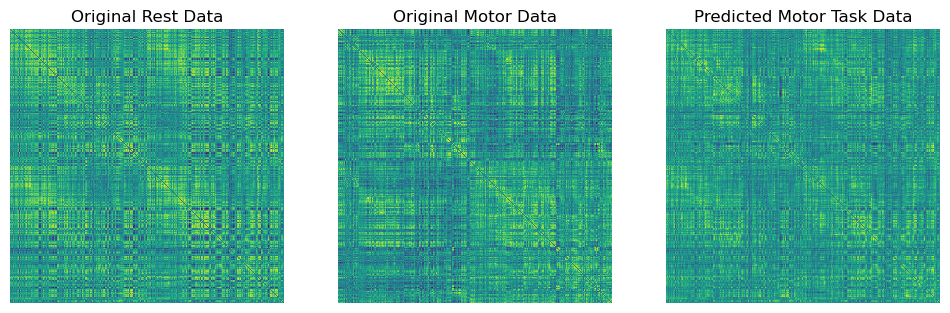

MSE: 0.04900817573070526


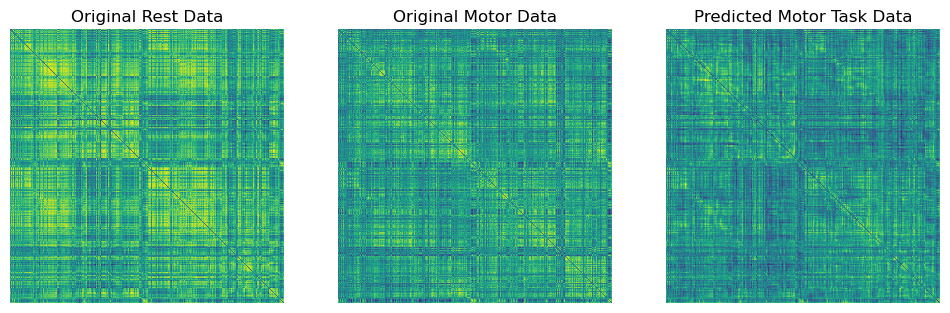

MSE: 0.04901833459734917


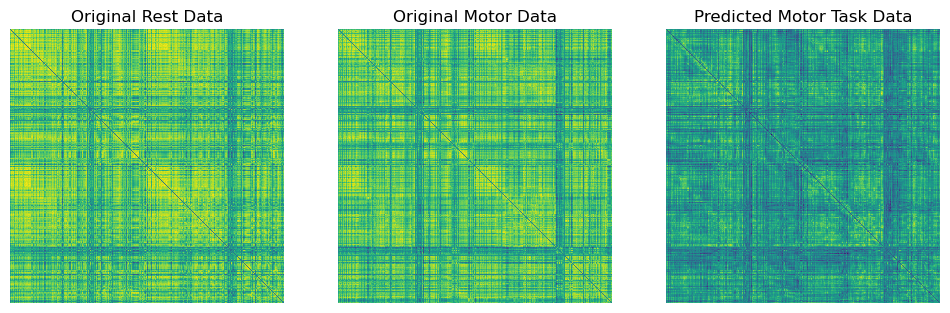

MSE: 0.06281952559947968


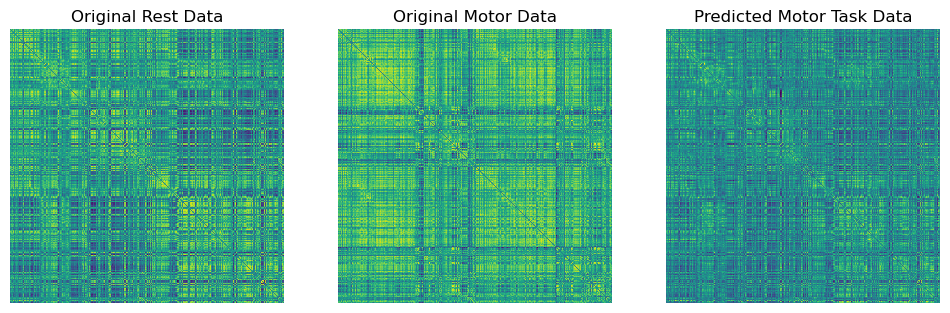

MSE: 0.07620546221733093


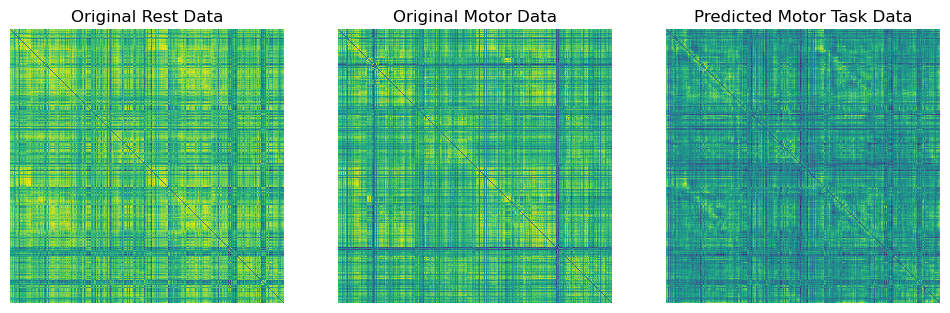

MSE: 0.05895615369081497


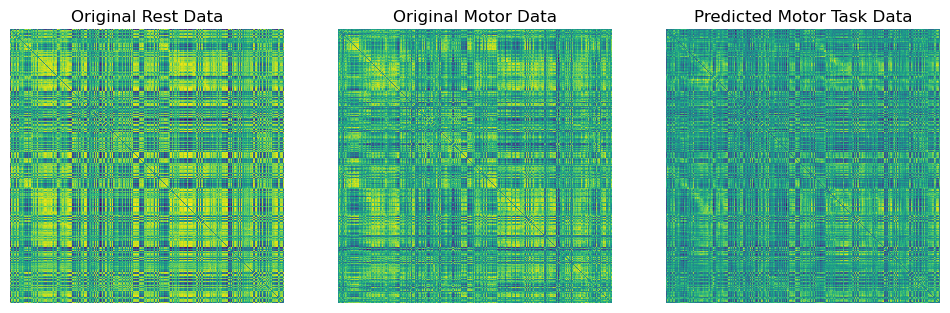

MSE: 0.053590551018714905


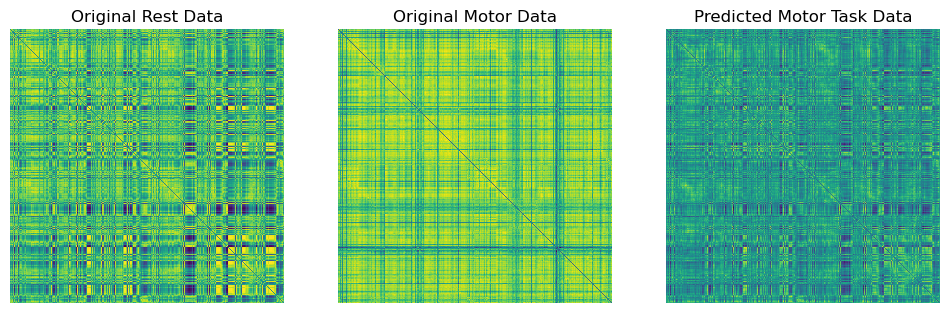

MSE: 0.11015795916318893


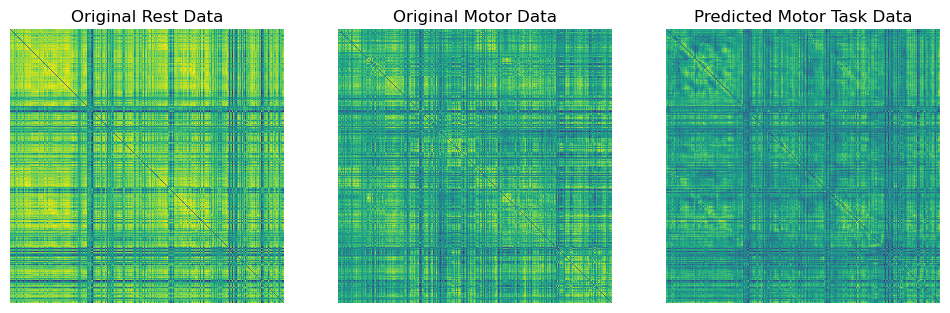

MSE: 0.06902334094047546


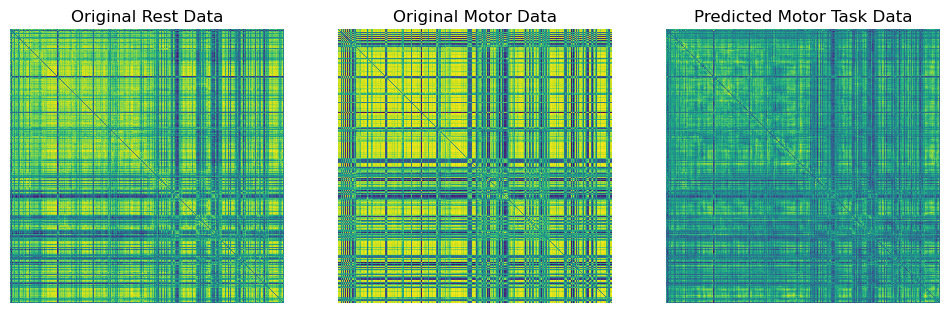

MSE: 0.13272102177143097


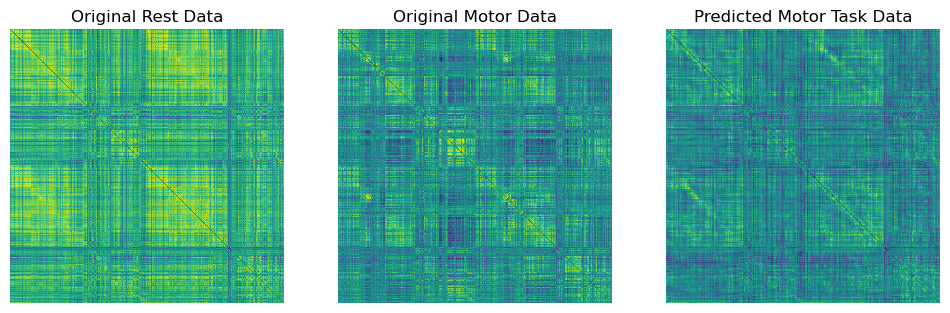

MSE: 0.049016788601875305


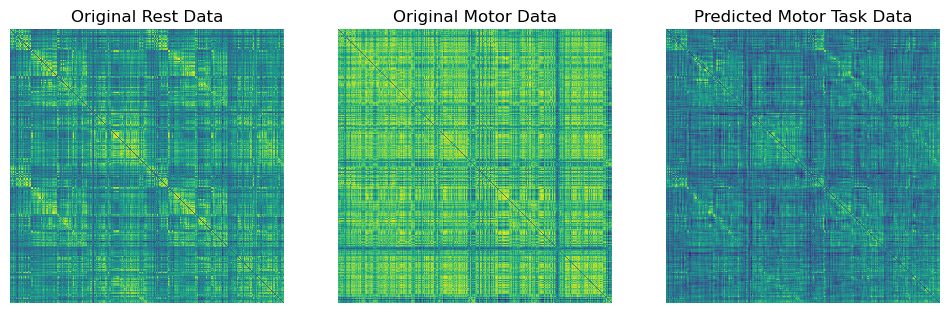

MSE: 0.05503612756729126


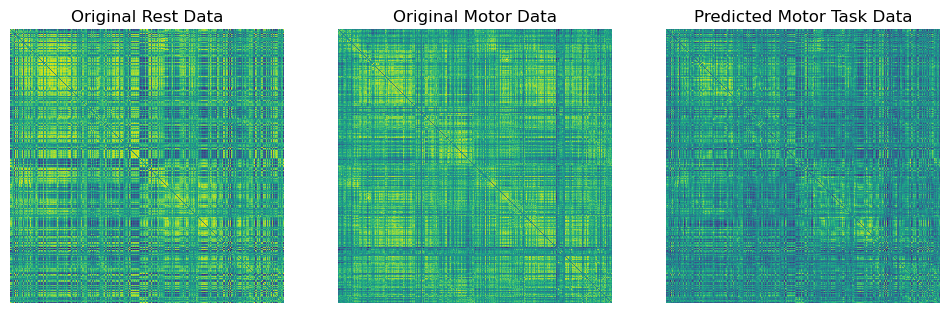

MSE: 0.06582718342542648


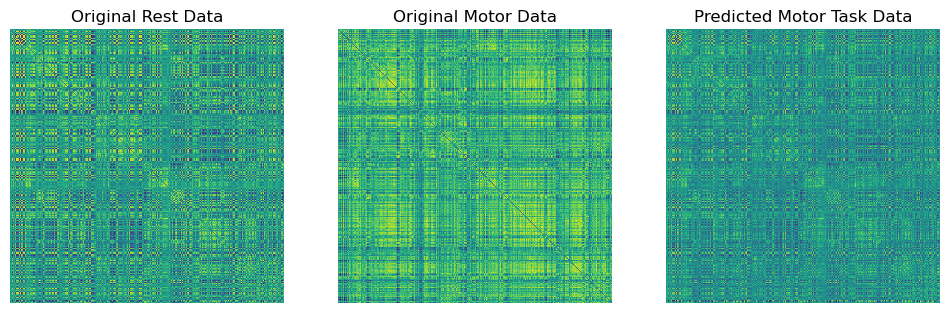

MSE: 0.0885392501950264


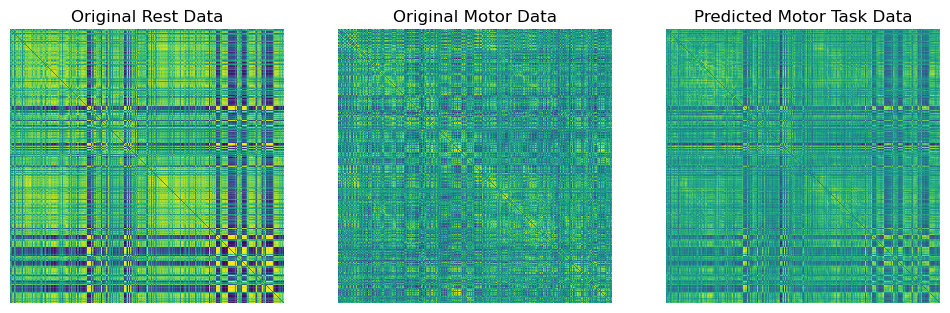

MSE: 0.07882323861122131


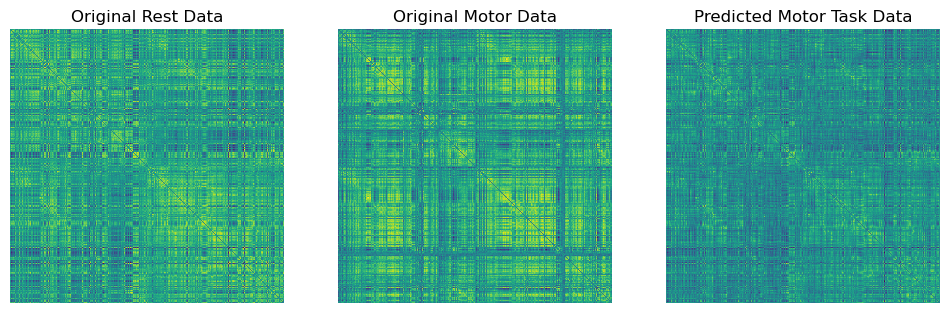

MSE: 0.058623477816581726


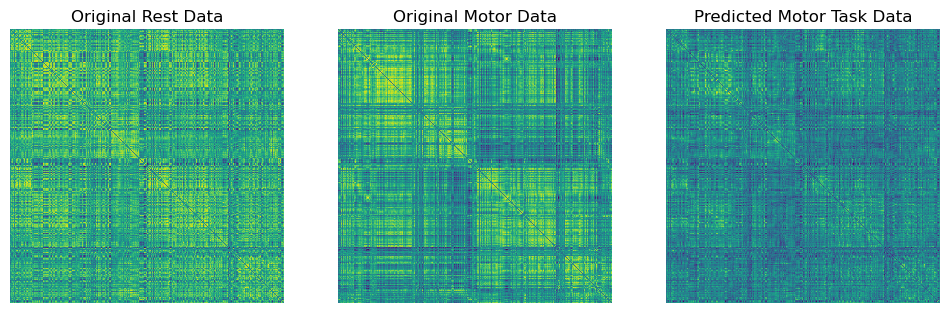

MSE: 0.06308203935623169


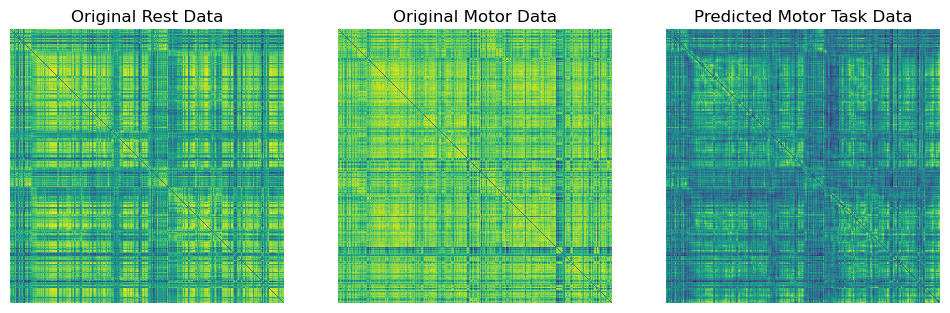

MSE: 0.062840536236763


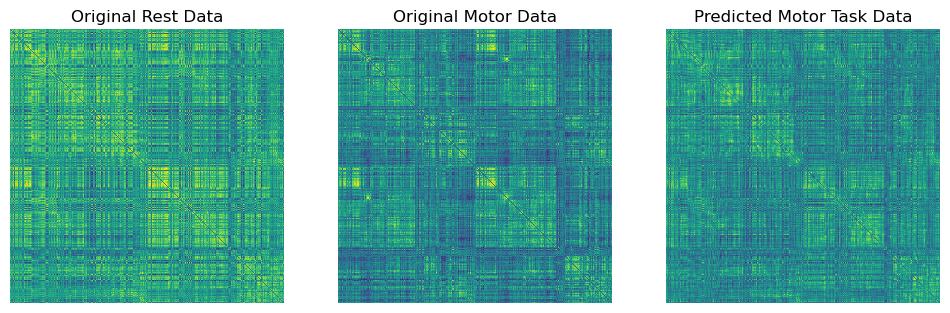

MSE: 0.04764055088162422


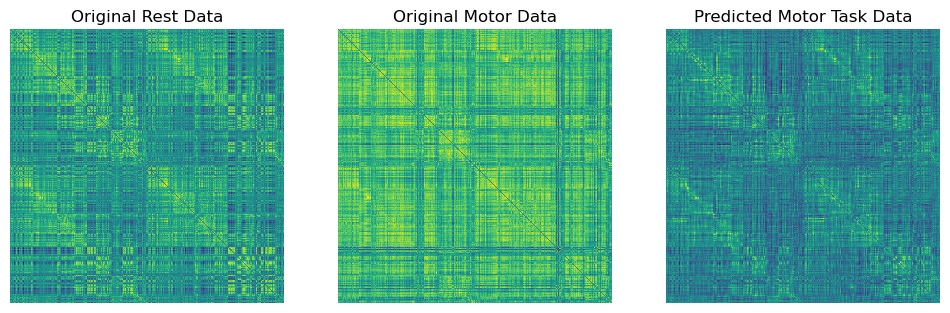

MSE: 0.07420293241739273


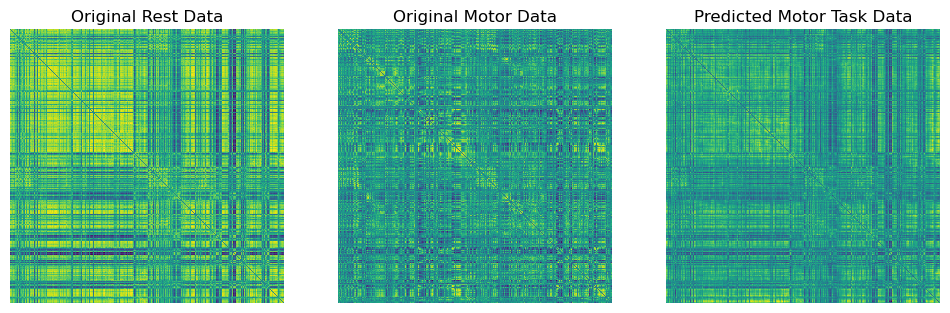

MSE: 0.08270314335823059


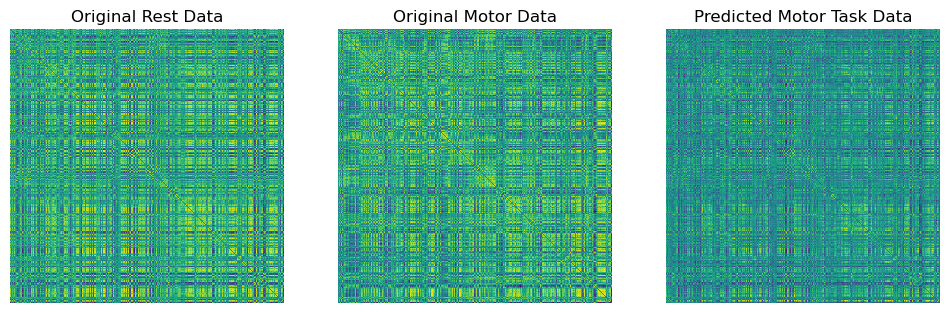

MSE: 0.06273846328258514


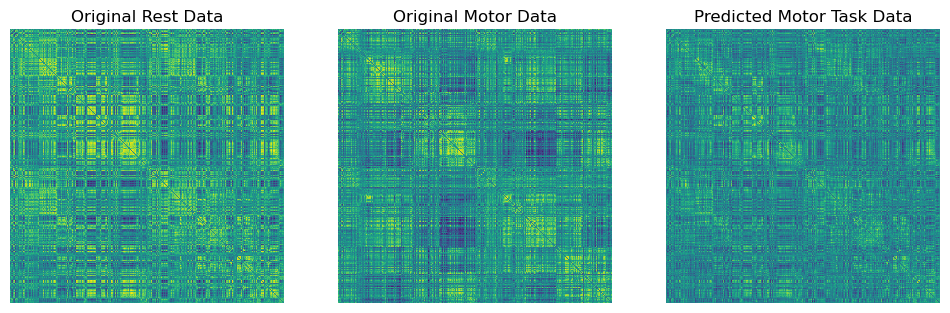

MSE: 0.061016570776700974


In [21]:
mse_loss_motor_all = []
MSELoss = torch.nn.MSELoss()
with torch.no_grad():
    for batch_data in test_data_loader:
        rest_batch = batch_data["rest_fMRI_data"].to(DEVICE)  # Ensure data is on the same device as your model
        motor_batch = batch_data["motor_task_fMRI_data"].to(DEVICE)
        T_X_test =  T(torch.tensor(rest_batch, device=DEVICE)).to(DEVICE)
        mse_loss_motor = MSELoss(T_X_test, motor_batch)
        mse_loss_motor_all.append(mse_loss_motor.cpu().detach().numpy())

        # Plot the original and predicted "motor" task data
        plot_original_and_predicted(rest_batch, motor_batch, T_X_test, 'Original Rest Data', 'Original Motor Data', 'Predicted Motor Task Data')
        print("MSE:", mse_loss_motor.item())

In [22]:
mse_loss_motor_all_100 = mse_loss_motor_all

In [23]:
import numpy as np

average = np.mean(mse_loss_motor_all_100)

std_deviation = np.std(mse_loss_motor_all_100)

print("Mean MSE for NOT with 100 steps:", average)
print("Std for MSE:", std_deviation)

Mean MSE for NOT with 100 steps: 0.07142738
Std for MSE: 0.018447505


# Paired NOT

## Network initialization

In [14]:
T_norm_layer = get_norm_layer(T_NORM)
D_norm_layer = get_norm_layer(D_NORM)

if D_TYPE == 'ResNet':
    D = ResNet_D(IMG_SIZE, nc=3 if not CONDITIONAL else 6, bn=D_NORM != 'none', use_dropout=D_DROPOUT).cuda()
    D.apply(weights_init_D)
elif D_TYPE == 'ResNet_pix2pix':
    D = NLayerDiscriminator(
        3 if not CONDITIONAL else 6, n_layers=3,
        norm_layer=D_norm_layer).cuda()
    init_weights(D)
else:
    raise NotImplementedError('Unknown D_TYPE: {}'.format(D_TYPE))

if T_TYPE == 'UNet':
    T = UNet(3, 3, base_factor=48).cuda()
elif T_TYPE == 'Unet_pix2pix':
    T = UnetGenerator(
        3, 3, num_downs=np.log2(IMG_SIZE).astype(int),
        use_dropout=T_DROPOUT, norm_layer=T_norm_layer
    ).cuda()
    init_weights(T)
elif T_TYPE == 'U2Net':
    T = U2NET(out_ch=3).cuda()
else:
    raise NotImplementedError('Unknown T_TYPE: {}'.format(T_TYPE))
    
if len(DEVICE_IDS) > 1:
    T = nn.DataParallel(T, device_ids=DEVICE_IDS)
    D = nn.DataParallel(D, device_ids=DEVICE_IDS)
    
print('T params:', np.sum([np.prod(p.shape) for p in T.parameters()]))
print('D params:', np.sum([np.prod(p.shape) for p in D.parameters()]))

NameError: name 'get_norm_layer' is not defined

In [ ]:
wandb.init(name=EXP_NAME, project='pairedot', entity='gunsandroses', config=config)
pass

In [1]:
T_opt = torch.optim.Adam(T.parameters(), lr=T_LR, weight_decay=1e-10)
D_opt = torch.optim.Adam(D.parameters(), lr=D_LR, weight_decay=1e-10)

T_scheduler = torch.optim.lr_scheduler.MultiStepLR(T_opt, milestones=[15000, 30000, 45000, 70000], gamma=0.5)
D_scheduler = torch.optim.lr_scheduler.MultiStepLR(D_opt, milestones=[15000, 30000, 45000, 70000], gamma=0.5)

# T_scheduler = torch.optim.lr_scheduler.StepLR(T_opt, step_size=1000, gamma=0.95)
# D_scheduler = torch.optim.lr_scheduler.StepLR(D_opt, step_size=1000, gamma=0.95)

if CONTINUE > -1:
    T_opt.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'T_opt_{SEED}_{CONTINUE}.pt')))
    T_scheduler.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'T_scheduler_{SEED}_{CONTINUE}.pt')))
    T.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'T_{SEED}_{CONTINUE}.pt')))
    D_opt.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'D_opt_{SEED}_{CONTINUE}.pt')))
    D.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'D_{SEED}_{CONTINUE}.pt')))
    D_scheduler.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'D_scheduler_{SEED}_{CONTINUE}.pt')))
    
#     if CONTINUE >= EMA_START:
#         freeze(T);
#         Ts_ema = [deepcopy(T) for ema in EMAS];
#         for ema, T_ema in zip(EMAS, Ts_ema):
#             T_ema.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'T_ema={ema}_{SEED}_{CONTINUE}.pt')))

NameError: name 'torch' is not defined

In [ ]:
for step in tqdm(range(CONTINUE+1, MAX_STEPS)):
    # T optimization
    unfreeze(T); freeze(D)
    for t_iter in range(T_ITERS): 
        T_opt.zero_grad()
        X, Y = XY_sampler.sample(BATCH_SIZE)
        T_X = T(X)
        
        if CONDITIONAL:
            T_X = torch.cat([T_X, X], dim=1)  
            
        if COST == 'rmse':
            T_loss = (Y-T_X[:, :3]).flatten(start_dim=1).norm(dim=1).mean()
        elif COST == 'mse':
            T_loss = (Y-T_X[:, :3]).flatten(start_dim=1).square().sum(dim=1).mean()
        elif COST == 'mae':
            T_loss = (Y-T_X[:, :3]).flatten(start_dim=1).abs().sum(dim=1).mean()
        elif COST == 'vgg':
            T_loss = vgg_loss(Y, T_X[:, :3]).mean()
        else:
            raise Exception('Unknown COST')  
            
        if NOT:
            T_loss -= D(T_X).mean()
            
        T_loss.backward(); T_opt.step()
    T_scheduler.step()
    del T_loss, T_X, X, Y; gc.collect(); torch.cuda.empty_cache()

    if NOT:
        # D optimization
        freeze(T); unfreeze(D)
        X, _ = XY_sampler.sample(BATCH_SIZE)
        with torch.no_grad():
            T_X = T(X)
        _, Y = XY_sampler.sample(BATCH_SIZE) # We may use the previous batch here
        if CONDITIONAL:
            with torch.no_grad():
                T_X = torch.cat([T_X, X], dim=1)
                Y = torch.cat([Y, X], dim=1)
        D_opt.zero_grad()
        D_loss = D(T_X).mean() - D(Y).mean()
        D_loss.backward(); D_opt.step(); D_scheduler.step()
        wandb.log({f'D_loss' : D_loss.item()}, step=step) 
        del D_loss, Y, X, T_X, _; gc.collect(); torch.cuda.empty_cache()
        
    # EMA for the transport map T
#     if step == EMA_START:
#         freeze(T);
#         Ts_ema = [deepcopy(T) for ema in EMAS];
#     elif step > EMA_START:
#         for ema, T_ema in zip(EMAS, Ts_ema):
#             ema_update(T_ema, T, ema)
        
    if step % PLOT_INTERVAL == 0:
        print('Plotting')
        clear_output(wait=True)

        fig, axes = plot_images(X_fixed, Y_fixed, T)
        wandb.log({'Fixed Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 
        
        fig, axes = plot_random_paired_images(XY_sampler_plt, T)
        wandb.log({'Random Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 
        
        fig, axes = plot_images(X_test_fixed, Y_test_fixed, T)
        wandb.log({'Fixed Test Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 
        
        fig, axes = plot_random_paired_images(XY_test_sampler_plt, T)
        wandb.log({'Random Test Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 
        
#         if step > EMA_START:
#             for ema, T_ema in zip(EMAS, Ts_ema):
#                 fig, axes = plot_images(X_test_fixed, Y_test_fixed, T_ema)
#                 wandb.log({'Fixed Test EMA={} Images'.format(ema) : [wandb.Image(fig2img(fig))]}, step=step) 
#                 plt.show(fig); plt.close(fig) 

#                 fig, axes = plot_random_paired_images(XY_test_sampler_plt, T_ema)
#                 wandb.log({'Random Test EMA={} Images'.format(ema) : [wandb.Image(fig2img(fig))]}, step=step) 
#                 plt.show(fig); plt.close(fig) 
    
    if step % CPKT_INTERVAL == CPKT_INTERVAL - 1:
        freeze(T); 
        torch.save(T.state_dict(), os.path.join(OUTPUT_PATH, f'T_{SEED}_{step}.pt'))
        torch.save(D.state_dict(), os.path.join(OUTPUT_PATH, f'D_{SEED}_{step}.pt'))
        torch.save(D_opt.state_dict(), os.path.join(OUTPUT_PATH, f'D_opt_{SEED}_{step}.pt'))
        torch.save(T_opt.state_dict(), os.path.join(OUTPUT_PATH, f'T_opt_{SEED}_{step}.pt'))
        torch.save(D_scheduler.state_dict(), os.path.join(OUTPUT_PATH, f'D_scheduler_{SEED}_{step}.pt'))
        torch.save(T_scheduler.state_dict(), os.path.join(OUTPUT_PATH, f'T_scheduler_{SEED}_{step}.pt'))
        
#         print('Computing EID and ECD')
#         EID, ECD = EnergyDistances(T, XY_test_sampler, size=1024)
#         wandb.log({'ECD' : ECD, 'EID' : EID}, step=step)
        
        print('Computing FID')
        mu, sigma = get_pushed_loader_stats(T, XY_test_sampler.loader,  n_epochs=FID_EPOCHS)
        fid = calculate_frechet_distance(mu_data, sigma_data, mu, sigma)
        wandb.log({f'FID (Test)' : fid}, step=step)
        del mu, sigma
        
        # Warning: this is surprisingly memory consiming
#         print('Computing paired metrics')
#         metrics = get_pushed_loader_metrics(T, XY_test_sampler.loader,  n_epochs=FID_EPOCHS)
#         for key, value in metrics.items():
#             wandb.log({f'{key} (Test)' : value}, step=step)
#         del metrics
        
        
#         if step > EMA_START:
#             for ema, T_ema in zip(EMAS, Ts_ema):
#                 torch.save(T_ema.state_dict(), os.path.join(OUTPUT_PATH, f'T_ema={ema}_{SEED}_{step}.pt'))

#                 print('Computing EMA={} FID'.format(ema))
#                 mu, sigma = get_pushed_loader_stats(T_ema, XY_test_sampler.loader,  n_epochs=FID_EPOCHS)
#                 fid = calculate_frechet_distance(mu_data, sigma_data, mu, sigma)
#                 wandb.log({f'FID (EMA={ema} Test)' : fid}, step=step)
#                 del mu, sigma
                
#                 print('Computing EMA={} paired metrics'.format(ema))
#                 metrics = get_pushed_loader_metrics(T_ema, XY_test_sampler.loader,  n_epochs=FID_EPOCHS)
#                 for key, value in metrics.items():
#                     wandb.log({f'{key} (Test)' : value}, step=step)
#                 del metrics
    
    gc.collect(); torch.cuda.empty_cache()

# Pix2Pix

In [3]:
class UnetGenerator(nn.Module):
    """Create a Unet-based generator"""

    def __init__(self, input_nc, output_nc, nf=64, norm_layer=nn.BatchNorm2d, use_dropout=False):
        """Construct a Unet generator
        Parameters:
            input_nc (int)  -- the number of channels in input images
            output_nc (int) -- the number of channels in output images
            num_downs (int) -- the number of downsamplings in UNet. For example, # if |num_downs| == 7,
                                image of size 128x128 will become of size 1x1 # at the bottleneck
            nf (int)       -- the number of filters in the last conv layer
            norm_layer      -- normalization layer
        We construct the U-Net from the innermost layer to the outermost layer.
        It is a recursive process.
        """
        super(UnetGenerator, self).__init__()
        # construct unet structure
        unet_block = UnetSkipConnectionBlock(nf * 8, nf * 8, input_nc=None, submodule=None, norm_layer=norm_layer, innermost=True)  # add the innermost layer
        
        # add intermediate layers with ngf * 8 filters
        unet_block = UnetSkipConnectionBlock(nf * 8, nf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
        unet_block = UnetSkipConnectionBlock(nf * 8, nf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
        unet_block = UnetSkipConnectionBlock(nf * 8, nf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
        
        # gradually reduce the number of filters from nf * 8 to nf
        unet_block = UnetSkipConnectionBlock(nf * 4, nf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        unet_block = UnetSkipConnectionBlock(nf * 2, nf * 4, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        unet_block = UnetSkipConnectionBlock(nf, nf * 2, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        self.model = UnetSkipConnectionBlock(output_nc, nf, input_nc=input_nc, submodule=unet_block, outermost=True, norm_layer=norm_layer)  # add the outermost layer

    def forward(self, input):
        """Standard forward"""
        return self.model(input)

In [4]:
class Discriminator(nn.Module):
    """Defines a PatchGAN discriminator"""

    def __init__(self, input_nc, ndf=64, n_layers=3, norm_layer=nn.BatchNorm2d):
        """Construct a PatchGAN discriminator
        Parameters:
            input_nc (int)  -- the number of channels in input images
            ndf (int)       -- the number of filters in the last conv layer
            n_layers (int)  -- the number of conv layers in the discriminator
            norm_layer      -- normalization layer
        """
        super(Discriminator, self).__init__()
        kw = 4
        padw = 1
        sequence = [nn.Conv2d(input_nc, ndf, kernel_size=kw, stride=2, padding=padw), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        nf_mult_prev = 1
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence += [
                nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=2, padding=padw, bias=False),
                norm_layer(ndf * nf_mult),
                nn.LeakyReLU(0.2, True)
            ]

        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence += [
            nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=1, padding=padw, bias=False),
            norm_layer(ndf * nf_mult),
            nn.LeakyReLU(0.2, True)
        ]

        sequence += [nn.Conv2d(ndf * nf_mult, 1, kernel_size=kw, stride=1, padding=padw), nn.Sigmoid()]  # output 1 channel prediction map
        self.model = nn.Sequential(*sequence)

    def forward(self, input):
        """Standard forward."""
        return self.model(input)

In [ ]:
import warnings
warnings.filterwarnings('ignore')

T.train(True)
f.eval()

for step in tqdm(range(MAX_STEPS)):
    T_opt_counter = 0
    for batch_data in train_data_loader:
        if T_opt_counter == T_ITERS:
            break 
        rest_batch = batch_data["rest_fMRI_data"].to(DEVICE)  # Ensure data is on the same device as your model
        motor_batch = batch_data["motor_task_fMRI_data"].to(DEVICE)
        T_loss = COST(rest_batch, T(rest_batch)).mean() - f(T(rest_batch)).mean()
        T_opt.zero_grad()
        T_loss.backward()
        T_opt.step()
        T_opt_counter += 1

    # f optimization
    T.eval()
    f.train(True)
    rest_batch = batch_data["rest_fMRI_data"].to(DEVICE)
    motor_batch = batch_data["motor_task_fMRI_data"].to(DEVICE)
    T_X_train = T(rest_batch).to(DEVICE)
    f_loss = f(T(rest_batch)).mean() - f(motor_batch).mean()
    f_opt.zero_grad()
    f_loss.backward()
    f_opt.step()
        
    if step % 10 == 0:
        clear_output(wait=True)
        print("Step", step)
        with torch.no_grad():
            T_X_test_fixed = T(test_data_motor.to(DEVICE))
            T_X_test_fixed = T_X_test_fixed.to('cpu')
            T_X_test_fixed_1 = T(test_data_motor_1.to(DEVICE))
            T_X_test_fixed_1 = T_X_test_fixed_1.to('cpu')
            T_X_test_fixed_2 = T(test_data_motor_2.to(DEVICE))
            T_X_test_fixed_2 = T_X_test_fixed_2.to('cpu')
            plot_original_and_predicted(test_data_rest, test_data_motor, T_X_test_fixed, 'original_rest_1', 'original_motor_1', 'predicted_1')
            plot_original_and_predicted(test_data_rest_1, test_data_motor_1, T_X_test_fixed_1, 'original_rest_2', 'original_motor_2', 'predicted_2')
            plot_original_and_predicted(test_data_rest_2, test_data_motor_2, T_X_test_fixed_2, 'original_rest_3', 'original_motor_3', 'predicted_3')
